# Skull strip using ANTS, FSL and the average of 20 sheep template

1. use ANTs to register the intact RT090 sheep to the template
2. there should be 5 output files including 3 transformation files and 2 images.
- GenericAffine.mat
- InverseWarp.nii.gz
- Warp.nii.gz
- FILE_NAME_into_template_InverseWarped.nii.gz
- FILE_NAME_into_template_Warped.nii.gz
3. Tranformations to bring the mask into RT090 space
- input is the mask
- reference is the InverseWarped image
- transforms (-t) unclude the GenericAffine.mat and InverseWarp
4. use the mask to skullstrip the RT090 sheep 
<br>

5. repeat steps 1 - 4 for the RT095 sheep
<br>
i.e.
- generate transoformation files
- Ants ApplyTransforms to bring the mask into RT095 space
- skull strip with fsl ApplyMask

In [1]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import scipy.io
import nibabel as nib
from nilearn import plotting
import nipype

In [2]:
from nipype.interfaces import ants

In [3]:
def quick_slice(f_name):
    '''quickly view a file as some slices'''

    plotting.plot_anat(f_name, title='', display_mode='ortho', dim=-1,
                       cut_coords=[5,-75,-30], draw_cross=False, radiological=True)

In [5]:
# Define file paths as easier-to-read variables
sheep_t1_090 = os.path.join(
    '/Users/tijmenvanslageren/Desktop/SS_with_template/',
    'RT090_Pre_T1_MPRAGE.nii.gz'
)
sheep_t1_095 = os.path.join(
    '/Users/tijmenvanslageren/Desktop/SS_with_template/',
    'RT095_Pre_T1_MPRAGE.nii.gz'
)

template = os.path.join(
    '/Users/tijmenvanslageren/Desktop/SS_with_template/template/',
    'T1_MPRAGE_template0.nii.gz'
)
template_mask = os.path.join(
    '/Users/tijmenvanslageren/Desktop/SS_with_template/template/',
    'T1_MPRAGE_template_mask.nii.gz'
)

view some of the files for sanity check

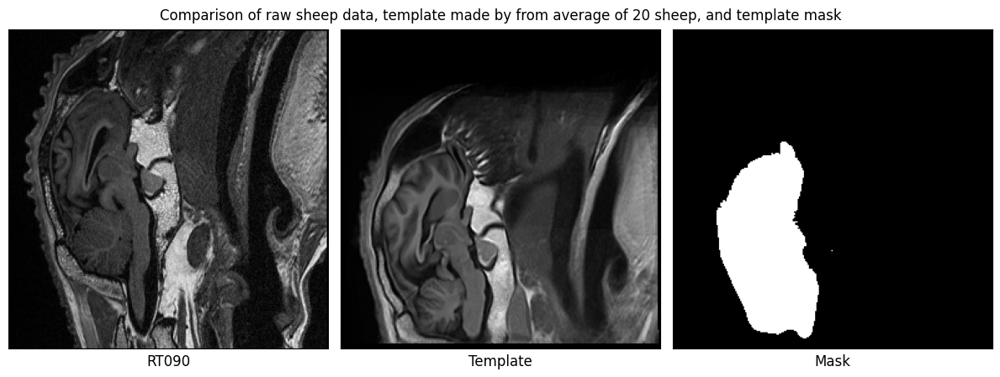

In [12]:
# Load NIfTI files
sheep_t1_090_nifti = nib.load(sheep_t1_090)
sheep_t1_090_data = sheep_t1_090_nifti.get_fdata()
template_nifti = nib.load(template)
template_data = template_nifti.get_fdata()
mask_nifti = nib.load(template_mask)
mask_data = mask_nifti.get_fdata()

# Plotting
fig, ax = plt.subplots(1, 3, figsize=(12, 4.5))

data_list = [sheep_t1_090_data, template_data, mask_data]
labels = ['RT090', 'Template', 'Mask']

for i in range(3):
    ax[i].imshow(np.rot90(data_list[i][43, :, :]), cmap='gray')
    ax[i].set_xlabel(labels[i], fontsize=12)
    ax[i].set_xticks([])
    ax[i].set_yticks([])

fig.tight_layout()
fig.suptitle('Comparison of raw sheep data, template made by from average of 20'
             ' sheep, and template mask')
plt.show()

## RT090 Sheep SkullStrip

### 1. use ANTsRegistration to generate neccesary transfomation files

In [ ]:
# use antRegistrationSyn from ants interface
from nipype.interfaces.ants import RegistrationSynQuick
regSyn = RegistrationSynQuick()

# moving the T1 of the RT090 sheep to the fixed template
regSyn.inputs.fixed_image = template
regSyn.inputs.moving_image = sheep_t1_090
regSyn.inputs.dimension = 3

# prefix the 5 resulting files with 'RT090_into_template'
# they currently output into the home directory
regSyn.inputs.output_prefix = 'RT090_into_template_'

# print the command line you would use in the terminal and inspect 
regSyn.cmdline

# comment out the run command so it doesnt run everytime 
# (takes 2min to run)
# regSyn.run()

'antsRegistrationSyNQuick.sh -d 3 -f /Users/tijmenvanslageren/Desktop/SS_with_template/template/T1_MPRAGE_template0.nii.gz -r 32 -m /Users/tijmenvanslageren/Desktop/SS_with_template/RT090_Pre_T1_MPRAGE.nii.gz -n 1 -o RT090_into_template_ -p d -s 26 -t s'

### 2. inspect the results of the above registration 

In [15]:
# Assign file paths to variables
inverse_warp = os.path.join(
    '/Users/tijmenvanslageren/Desktop/SS_with_template/RT090_register_to_template_files/',
    'RT090_into_template_1InverseWarp.nii.gz'
)
warp = os.path.join(
    '/Users/tijmenvanslageren/Desktop/SS_with_template/RT090_register_to_template_files/',
    'RT090_into_template_1Warp.nii.gz'
)
inverse_warped_image = os.path.join(
    '/Users/tijmenvanslageren/Desktop/SS_with_template/RT090_register_to_template_files/',
    'RT090_into_template_InverseWarped.nii.gz'
)
warped_image = os.path.join(
    '/Users/tijmenvanslageren/Desktop/SS_with_template/RT090_register_to_template_files/',
    'RT090_into_template_Warped.nii.gz'
)

# Define the path to the .mat file
linear_transform = os.path.join(
    '/Users/tijmenvanslageren/Desktop/SS_with_template/RT090_register_to_template_files/',
    'RT090_into_template_0GenericAffine.mat'
)

Linear Transform matlab file

In [22]:
# Load the MATLAB file
matlab_file = scipy.io.loadmat(linear_transform)

# Print the keys in the MATLAB file
keys = [key for key in matlab_file.keys() if not key.startswith('__')]
print("Keys in the MATLAB file:", keys)

# Display the contents of each key
for key in keys:
    print(f"\nContents of key '{key}':")
    data = matlab_file[key]
    if data.ndim == 2:  # Check if the data is a 2D array
        df = pd.DataFrame(data)
        display(df)
    else:
        print(data)

Keys in the MATLAB file: ['AffineTransform_double_3_3', 'fixed']

Contents of key 'AffineTransform_double_3_3':


,0
0,0.996880
1,-0.032845
2,-0.025519
3,0.057725
4,0.977957
5,0.011754
6,0.031343
7,-0.052910
8,0.994085
9,0.960336



Contents of key 'fixed':


,0
0,-2.937854
1,42.070676
2,-21.164724


inspect warped and inverse warped images as compared with the original RT090 file 

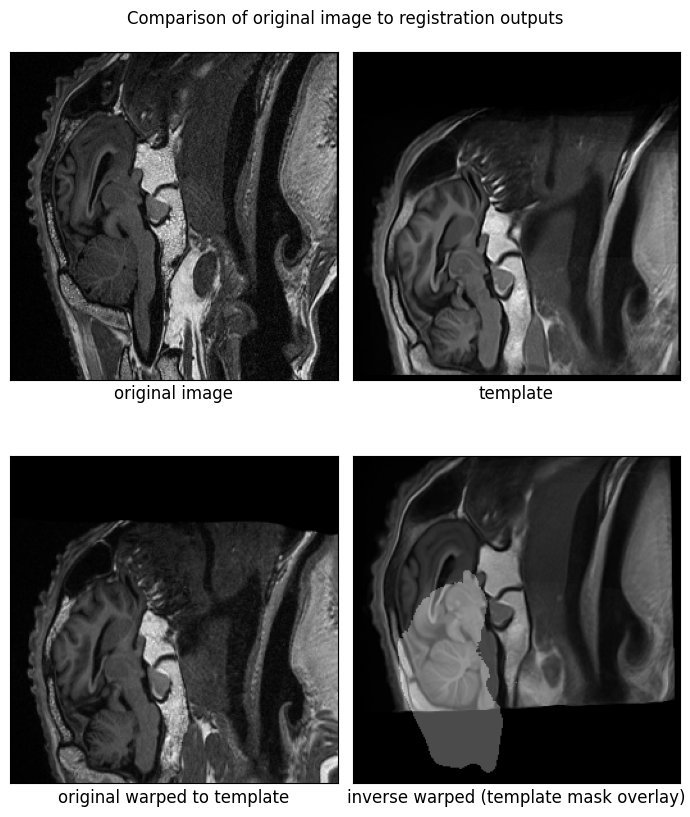

In [ ]:
'''Comment on figure: The warped image is squashed down like the template
The inverse warp image is more like the raw RT090, as expected '''

# Load NIfTI files
warped_image_nifti = nib.load('/Users/tijmenvanslageren/Desktop/'
                              'SS_with_template/RT090_register_to_template_files/'
                              'RT090_into_template_Warped.nii.gz')
warped_image_data = warped_image_nifti.get_fdata()
inverse_warped_image_nifti = nib.load(inverse_warped_image)
inverse_warped_image_data = inverse_warped_image_nifti.get_fdata()

# Plotting
fig, ax = plt.subplots(2, 2, figsize=(7, 8.5))

data_list = [
    (sheep_t1_090_data, 'original image'),
    (template_data, 'template'),
    (warped_image_data, 'original warped to template'),
    (inverse_warped_image_data, 'inverse warped (template mask overlay)')
]

for i, (data, label) in enumerate(data_list):
    row, col = divmod(i, 2)
    ax[row, col].imshow(np.rot90(data[43, :, :]), cmap='gray')
    ax[row, col].set_xlabel(label, fontsize=12)
    ax[row, col].set_xticks([])
    ax[row, col].set_yticks([])

# Overlay the mask on the inverse warped image
ax[1, 1].imshow(np.rot90(mask_data[43, :, :]), alpha=0.3, cmap='gray')

fig.tight_layout()
fig.suptitle('Comparison of original image to registration outputs')

plt.show()

Check the registered image is aligned with the mask as it appears in template space

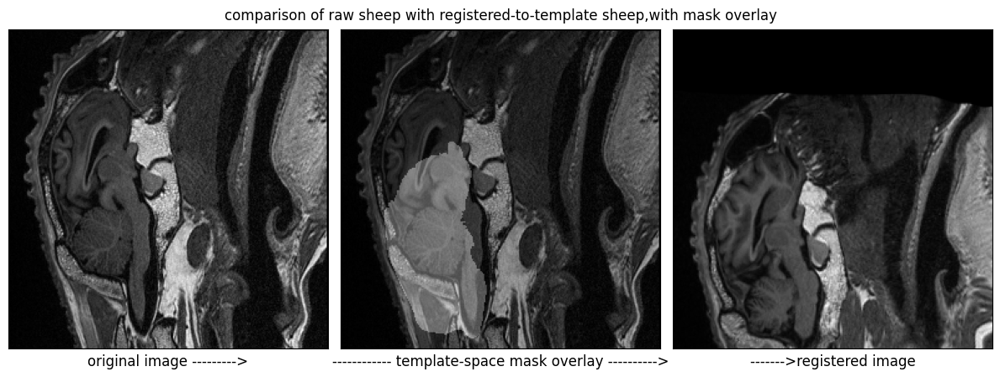

In [27]:
# alignment check


fig, ax= plt.subplots(1, 3, figsize=(12,4.5))

ax[0].imshow(np.rot90(sheep_t1_090_data[43, :, :]), cmap='gray')
ax[0].set_xlabel('original image --------->', 
                 fontsize=12)
ax[0].set_xticks([])
ax[0].set_yticks([])
ax[1].imshow(np.rot90(sheep_t1_090_data[43, :, :]), cmap='gray')
ax[1].imshow(np.rot90(mask_data[43, :, :]), alpha=0.3, cmap='gray')
ax[1].set_xlabel('------------ template-space mask overlay ---------->',
                fontsize=12)
ax[1].set_xticks([])
ax[1].set_yticks([])
ax[2].imshow(np.rot90(warped_image_data[43, :, :]), cmap='gray')
ax[2].set_xlabel('------->registered image', 
                 fontsize=12)
ax[2].set_xticks([])
ax[2].set_yticks([])

fig.tight_layout()
fig.suptitle('comparison of raw sheep with registered-to-template sheep,'
            'with mask overlay')

plt.show()

### 3. Bring mask into RT090 space

use the inverse warp and transformation files on the mask

In [ ]:
# import the ants 'apply transforms' module
from nipype.interfaces.ants import ApplyTransforms

# Assign the ApplyTransforms module to 'at' and specify 3D images
at = ApplyTransforms()
at.inputs.dimension = 3

# Input the template mask
at.inputs.input_image = template_mask

# Reference the inverse of the warped image as moving from template space
# to RT090 space
at.inputs.reference_image = inverse_warped_image

# Specify the transformations (the affine matrix and the inverse warp)
# Will be run in reverse according to documentation
at.inputs.transforms = [linear_transform, inverse_warp]

# Make sure to reverse the linear transform
at.inputs.invert_transform_flags = [True, False]

# set the interpolation to 'MultiLabel' to preserve the binary mask
at.inputs.interpolation = 'MultiLabel'

# Specify the name of the output file
at.inputs.output_image = '/Users/tijmenvanslageren/Desktop/SS_with_template/template/mask_in_RT090_space.nii.gz'


view mask in RT090 space (in red), as compred to in template-space (in white), on a background of the original RT090 image

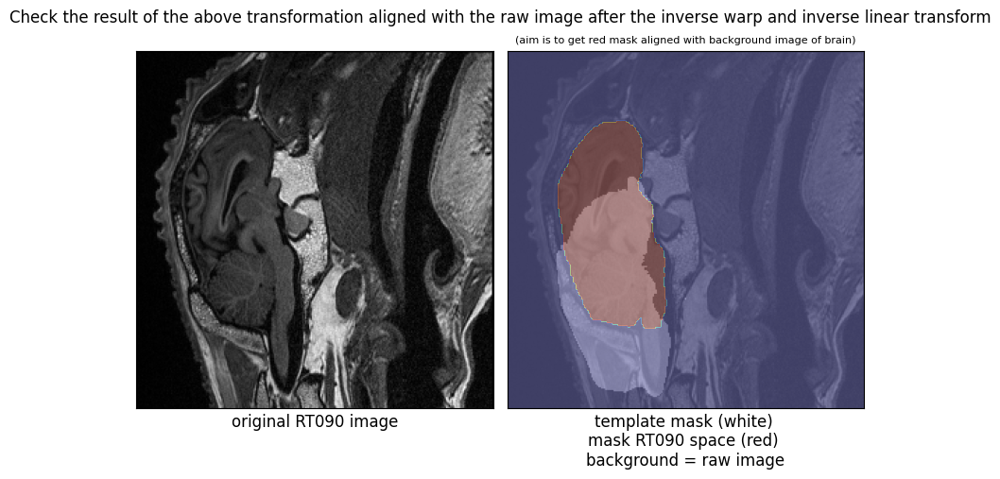

In [29]:
# Specify path to mask in RT090 space and load it as a NIfTI file and get the data
mask_in_090_space_path = os.path.join('/Users/tijmenvanslageren/Desktop/SS_with_template/template/mask_in_RT090_space.nii.gz')
mask_in_090_space_nifti = nib.load(mask_in_090_space_path)
mask_in_090_space_data = mask_in_090_space_nifti.get_fdata()

# Plot the result of the inverse transform
fig, ax = plt.subplots(1, 2, figsize=(8, 5))

# Original RT090 image
ax[0].imshow(np.rot90(sheep_t1_090_data[43, :, :]), cmap='gray')
ax[0].set_xlabel('original RT090 image', fontsize=12)
ax[0].set_xticks([])
ax[0].set_yticks([])

# Template mask and mask in RT090 space overlaid on the original image
ax[1].imshow(np.rot90(sheep_t1_090_data[43, :, :]), cmap='gray', alpha=0.5)
ax[1].imshow(np.rot90(mask_data[43, :, :]), alpha=0.3, cmap='gray')
ax[1].imshow(np.rot90(mask_in_090_space_data[43, :, :]), alpha=0.3, cmap='jet')
ax[1].set_xlabel('template mask (white) \nmask RT090 space (red) \nbackground = raw image', fontsize=12)
ax[1].set_title('(aim is to get red mask aligned with background image of brain)', fontsize=8)
ax[1].set_xticks([])
ax[1].set_yticks([])

# Adjust layout and add title
fig.tight_layout()
fig.suptitle('Check the result of the above transformation aligned with the raw image after the inverse warp and inverse linear transform')

# Show the plot
plt.show()

### 4. apply the mask in RT090 space to the RT090 raw data to SkullStrip

using fsl 'Apply_mask'

In [30]:
# import relevant module from fsl maths
from nipype.interfaces.fsl import maths



bet1 = maths.ApplyMask()
bet1.inputs.in_file = sheep_t1_090
bet1.inputs.mask_file = mask_in_090_space_path
bet1.inputs.out_file = '/Users/tijmenvanslageren/Desktop/SS_with_template/RT090_Pre_T1_MPRAGE_brain.nii.gz'
first_bet = bet1.run()

view results

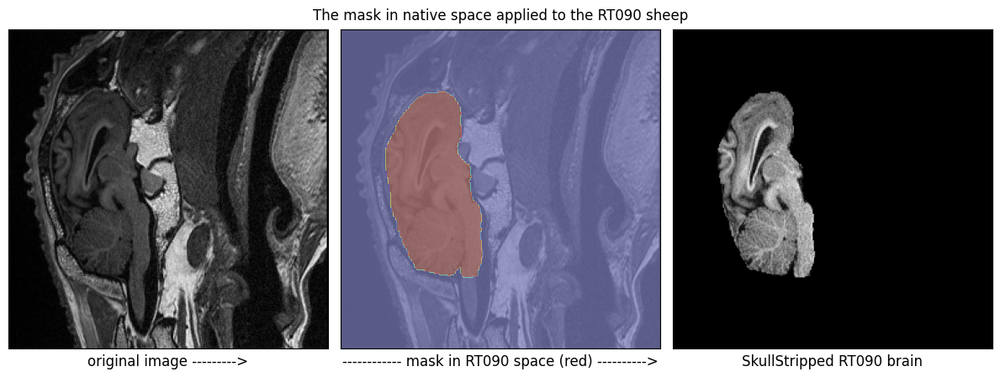

In [32]:
# load the mask in 090 space and skullstripped RT090 and grab the data


Sheep_T1_090_brain = nib.load('/Users/tijmenvanslageren/Desktop/SS_with_template/RT090_Pre_T1_MPRAGE_brain.nii.gz')
Sheep_T1_090_brain_data = Sheep_T1_090_brain.get_fdata()

fig, ax= plt.subplots(1, 3, figsize=(12,4.5))

ax[0].imshow(np.rot90(sheep_t1_090_data[43, :, :]), cmap='gray')
ax[0].set_xlabel('original image --------->', fontsize=12)
ax[0].set_xticks([])
ax[0].set_yticks([])
ax[1].imshow(np.rot90(mask_in_090_space_data[43, :, :]), cmap='jet', alpha=0.5)
ax[1].imshow(np.rot90(sheep_t1_090_data[43, :, :]), cmap='gray', alpha=0.3)
ax[1].set_xlabel('------------ mask in RT090 space (red) ---------->', fontsize=12)
ax[1].set_xticks([])
ax[1].set_yticks([])
ax[2].imshow(np.rot90(Sheep_T1_090_brain_data[43, :, :]), cmap='gray')
ax[2].set_xlabel('SkullStripped RT090 brain', fontsize=12)
ax[2].set_xticks([])
ax[2].set_yticks([])

fig.tight_layout()
fig.suptitle('The mask in native space applied to the RT090 sheep')

plt.show()

3D representation of skullstripped brain (in red) on original RT090 background

/Users/tijmenvanslageren/miniconda3/envs/SS_project/lib/python3.10/site-packages/numpy/core/fromnumeric.py:771: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)



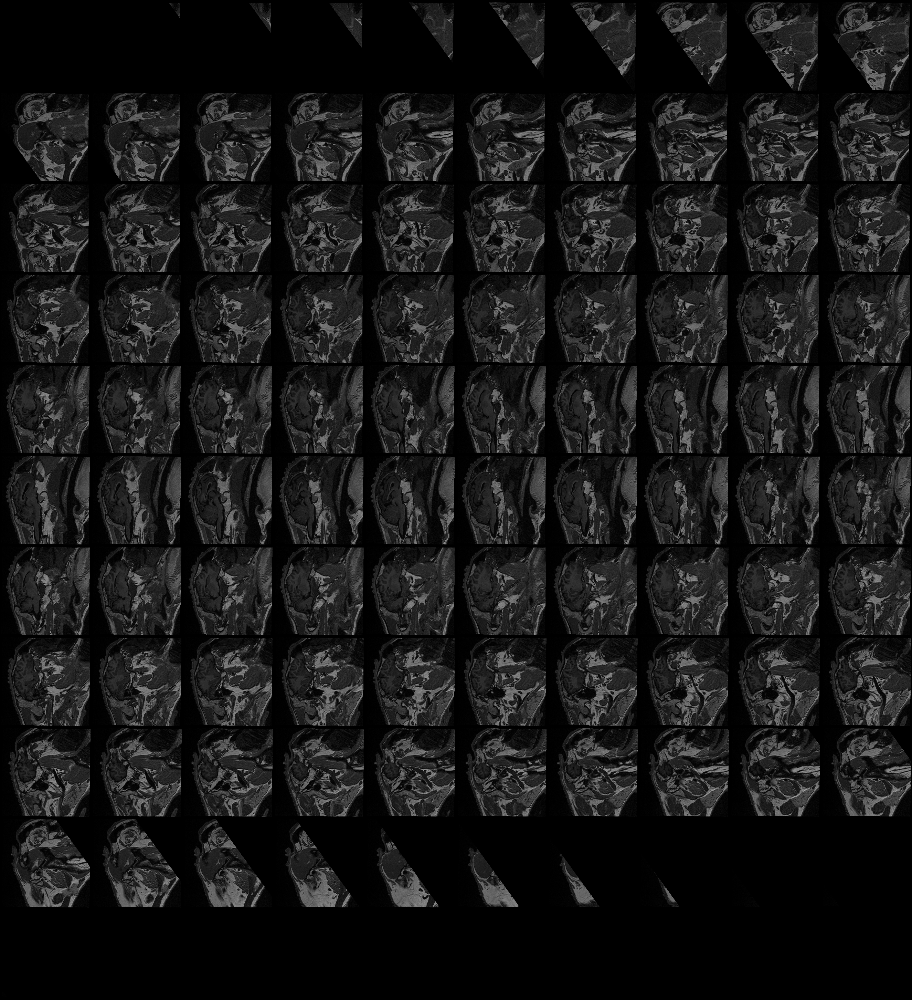
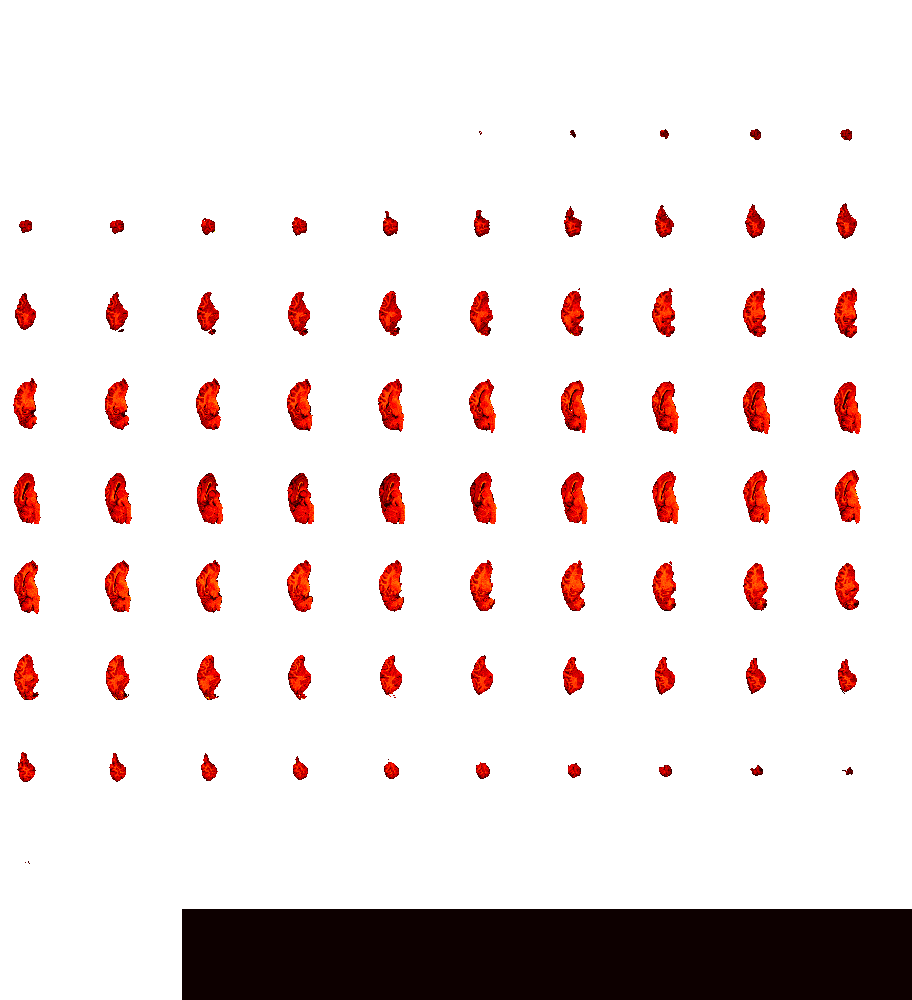

In [33]:
plotting.view_img(Sheep_T1_090_brain, bg_img=sheep_t1_090, title='RT090 brain')

## RT095 Sheep SkullStrip

In [34]:
Sheep_T1_095 = os.path.join('/Users/tijmenvanslageren/Desktop/SS_with_template/RT095_Pre_T1_MPRAGE.nii.gz')

template = os.path.join('/Users/tijmenvanslageren/Desktop/SS_with_template/template/T1_MPRAGE_template0.nii.gz')
template_mask = os.path.join('/Users/tijmenvanslageren/Desktop/SS_with_template/template/T1_MPRAGE_template_mask.nii.gz')

#### Register with ANTs

In [35]:
# use antRegistrationSyn from ants interface
from nipype.interfaces.ants import RegistrationSynQuick
regSyn = RegistrationSynQuick()

# moving the T1 of the RT090 sheep to the fixed template
regSyn.inputs.fixed_image = template
regSyn.inputs.moving_image = Sheep_T1_095
regSyn.inputs.dimension = 3

# prefix the 5 resulting files with 'RT090_into_template'
# they currently output into the home directory
regSyn.inputs.output_prefix = 'RT095_into_template_'

# print the command line you would use in the terminal and inspect 
regSyn.cmdline

# comment out the run command so it doesnt run everytime (takes 2min to run)
# regSyn.run()

'antsRegistrationSyNQuick.sh -d 3 -f /Users/tijmenvanslageren/Desktop/SS_with_template/template/T1_MPRAGE_template0.nii.gz -r 32 -m /Users/tijmenvanslageren/Desktop/SS_with_template/RT095_Pre_T1_MPRAGE.nii.gz -n 1 -o RT095_into_template_ -p d -s 26 -t s'

Apply transforms to bring mask into RT095 space

In [36]:
# specify paths to RT095 files

RT095_Generic_affine = os.path.join('/Users/tijmenvanslageren/Desktop/SS_with_template/RT095_register_to_template_files/RT095_into_template_0GenericAffine.mat')
RT095_inverse_warp = os.path.join('/Users/tijmenvanslageren/Desktop/SS_with_template/RT095_register_to_template_files/RT095_into_template_1InverseWarp.nii.gz')
RT095_warp = os.path.join('/Users/tijmenvanslageren/Desktop/SS_with_template/RT095_register_to_template_files/RT095_into_template_1Warp.nii.gz')
RT095_InverseWarped_Image = os.path.join('/Users/tijmenvanslageren/Desktop/SS_with_template/RT095_register_to_template_files/RT095_into_template_InverseWarped.nii.gz')
RT095_Warped_Image = os.path.join('/Users/tijmenvanslageren/Desktop/SS_with_template/RT095_register_to_template_files/RT095_into_template_Warped.nii.gz')


In [37]:
# import the ants 'apply transforms' module
from nipype.interfaces.ants import ApplyTransforms

# assign it to 'at' and specify 3D images
at = ApplyTransforms()
at.inputs.dimension = 3

# input the template mask
at.inputs.input_image = template_mask

# reference the inverse of the warped image as moving from template space to RT090 space
at.inputs.reference_image = RT095_InverseWarped_Image

# specify the trasnformations (the affine matrix and the inverse warp)
# will be run in reverse according to documentation
at.inputs.transforms = RT095_Generic_affine, RT095_inverse_warp
at.inputs.invert_transform_flags = [True, False]
at.inputs.interpolation = 'MultiLabel'

# specify the name of the output file 
at.inputs.output_image = '/Users/tijmenvanslageren/Desktop/SS_with_template/template/mask_in_RT095_space.nii.gz'

# output what would go into the terminal
at.cmdline

# run 
mask_to_RT090_transform = at.run()

skullstrip RT095 in native space with the native space RT095 mask

In [38]:
mask_in_095_space = os.path.join('/Users/tijmenvanslageren/Desktop/SS_with_template/template/mask_in_RT095_space.nii.gz')

bet2 = maths.ApplyMask()
bet2.inputs.in_file = Sheep_T1_095
bet2.inputs.mask_file = mask_in_095_space
bet2.inputs.out_file = '/Users/tijmenvanslageren/Desktop/SS_with_template/RT095_Pre_T1_MPRAGE_brain.nii.gz'
second_bet = bet2.run()

View result (red) on background of original RT095 image

/Users/tijmenvanslageren/miniconda3/envs/SS_project/lib/python3.10/site-packages/numpy/core/fromnumeric.py:771: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)



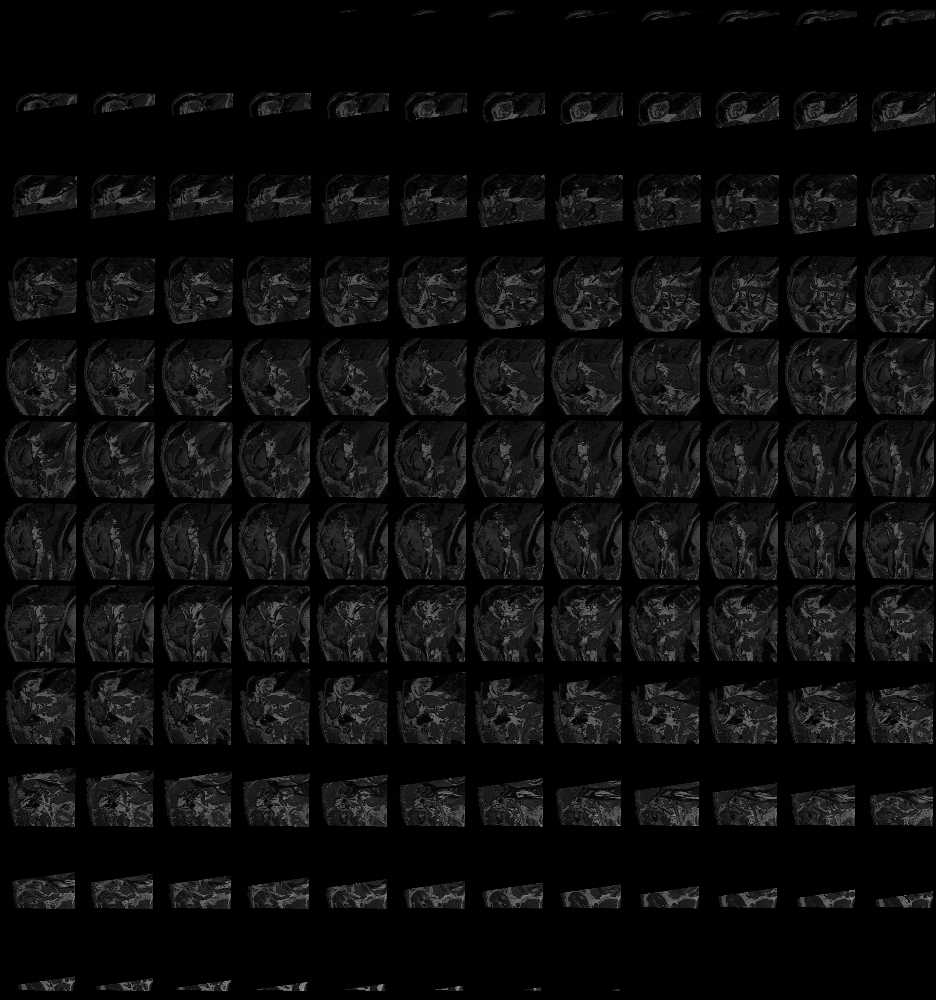
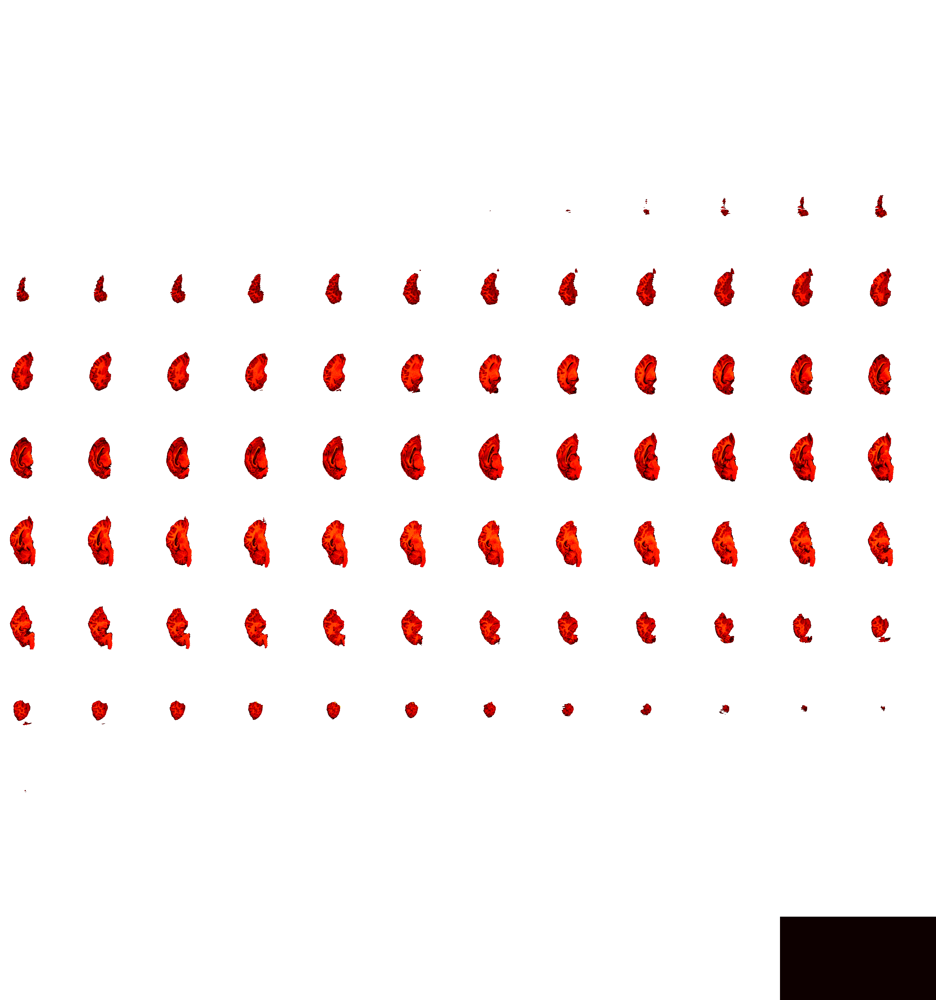

In [39]:
Sheep_T1_095_brain = os.path.join('/Users/tijmenvanslageren/Desktop/SS_with_template/RT095_Pre_T1_MPRAGE_brain.nii.gz')

plotting.view_img(Sheep_T1_095_brain, bg_img=Sheep_T1_095, title='RT095 brain')

## End result

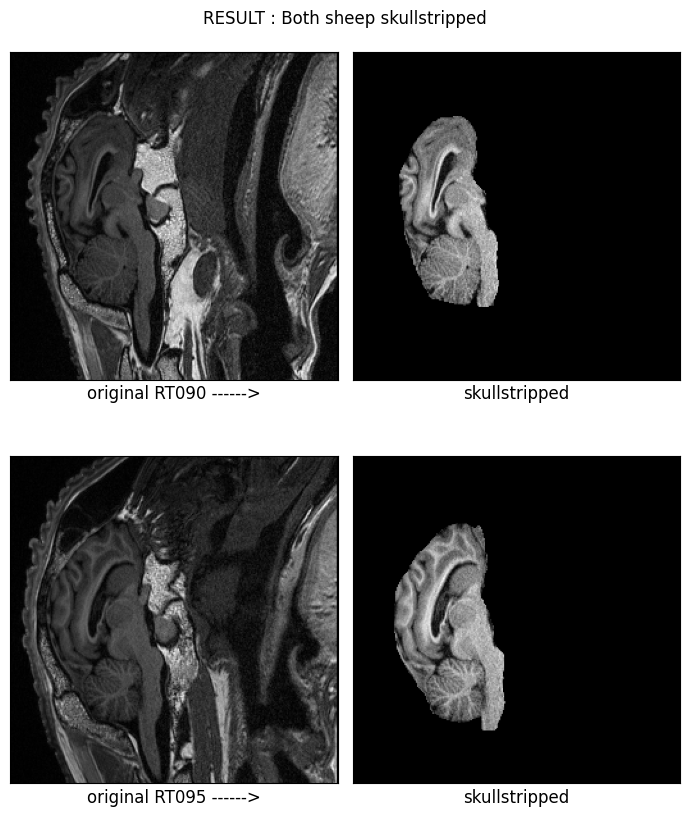

In [41]:
Sheep_095_nifti = nib.load(Sheep_T1_095)
Sheep_095_nifti_data = Sheep_095_nifti.get_fdata()

Sheep_095_brain_nifti = nib.load(Sheep_T1_095_brain)
Sheep_095_brain_nifti_data = Sheep_095_brain_nifti.get_fdata()


fig, ax= plt.subplots(2, 2, figsize=(7,8.5))

ax[0,0].imshow(np.rot90(sheep_t1_090_data[43, :, :]), cmap='gray')
ax[0,0].set_xlabel('original RT090 ------>', fontsize=12)
ax[0,0].set_xticks([])
ax[0,0].set_yticks([])
ax[0,1].imshow(np.rot90(Sheep_T1_090_brain_data[43, :, :]), cmap='gray')
ax[0,1].set_xlabel('skullstripped', fontsize=12)
ax[0,1].set_xticks([])
ax[0,1].set_yticks([])
ax[1,0].imshow(np.rot90(Sheep_095_nifti_data[43, :, :]), cmap='gray')
ax[1,0].set_xlabel('original RT095 ------>', fontsize=12)
ax[1,0].set_xticks([])
ax[1,0].set_yticks([])
ax[1,1].imshow(np.rot90(Sheep_095_brain_nifti_data[43, :, :]), cmap='gray')
ax[1,1].set_xlabel('skullstripped', fontsize=12)
ax[1,1].set_xticks([])
ax[1,1].set_yticks([])

fig.tight_layout()
fig.suptitle('RESULT : Both sheep skullstripped')

plt.show()

# END